# RFM

**Context:**

Notre groupe a été mendaté pour realisé une analyse des clients à partir des données en notre possession. Nous allons utilisé une segmentation RFM.

La segmentation RFM permet de calculer la valeur des clients et ainsi de les segmenter en fonction de leurs habitudes de consommation. On les distingue ainsi selon leurs typologies : ambassadeurs, très bons clients, bons clients et clients inactifs.

Le but est de pouvoir ensuite réaliser un plan d’actions marketing plus pertinent pour chaque segment selon leurs intentions d’achatet permettra: 

- de déterminer la valeur des clients
- d’analyser le comportement d’achat
- de prédire les comportements des clients

# preprocessing

## Import

In [1]:
# import des librairie

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from operator import attrgetter
import matplotlib.colors as mcolors
from datetime import timedelta
import plotly.express as px
import squarify

In [2]:
# Fonction

In [3]:
def missing_zero_values_table(df):
        '''Fonction pour regarder les valeurs manquantes'''
        zero_val = (df == 0.00).astype(int).sum(axis=0)
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)
        mz_table = mz_table.rename(
        columns = {0 : 'Zero Values', 1 : 'Missing Values', 2 : '% of Total Values'})
        mz_table['Total Zero Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
        mz_table['% Total Zero Missing Values'] = 100 * mz_table['Total Zero Missing Values'] / len(df)
        mz_table['Data Type'] = df.dtypes
        mz_table = mz_table[
            mz_table.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
        return mz_table

In [4]:
def plot_multiple_boxplots(df):
    '''permet de ploter les differentes colonnes numerique en boxplot'''
    numeric_cols = df.select_dtypes(include='number').columns
    for col in numeric_cols:
        sns.boxplot(x=df[col])
        plt.title(col)
        plt.show()

In [5]:
def outlier_identificator(df,colonne):
    '''Identification des outlier methode quantile'''
    q1=np.quantile(df[colonne],0.25)
    q3=np.quantile(df[colonne],0.75)
    out= (q3+1.5*(q3-q1)) 
    outlier=df.loc[df[colonne]> out]
    outlier = outlier.sort_values(by=colonne, ascending = False)
    return outlier

In [6]:
# import des données
data = pd.read_csv("db_customers.csv")
data = data.drop("Unnamed: 0", axis=1)
data = data.drop("customer_id", axis=1)
data

,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,payment_type,payment_installments,payment_value,review_score,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,product_category_name_english
0,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,credit_card,1.0,18.12,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares
1,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,voucher,1.0,2.00,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares
2,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,voucher,1.0,18.59,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares
3,53cdb2fc8bc7dce0b6741e2150273451,delivered,2018-07-24 20:41:37,2018-08-07 15:27:45,boleto,1.0,141.46,4,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,perfumery
4,47770eb9100c2d0c44946d9cf07ec65d,delivered,2018-08-08 08:38:49,2018-08-17 18:06:29,credit_card,3.0,179.12,5,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,auto
...,...,...,...,...,...,...,...,...,...,...,...,...,...
105378,9c5dedf39a927c1b2549525ed64a053c,delivered,2017-03-09 09:54:05,2017-03-17 15:08:01,credit_card,3.0,85.08,5,6359f309b166b0196dbf7ad2ac62bb5a,12209,sao jose dos campos,SP,health_beauty
105379,63943bddc261676b46f01ca7ac2f7bd8,delivered,2018-02-06 12:58:58,2018-02-28 17:37:56,credit_card,3.0,195.00,4,da62f9e57a76d978d02ab5362c509660,11722,praia grande,SP,baby
105380,83c1379a015df1e13d02aae0204711ab,delivered,2017-08-27 14:46:43,2017-09-21 11:24:17,credit_card,5.0,271.01,5,737520a9aad80b3fbbdad19b66b37b30,45920,nova vicosa,BA,home_appliances_2
105381,11c177c8e97725db2631073c19f07b62,delivered,2018-01-08 21:28:27,2018-01-25 23:32:54,credit_card,4.0,441.16,2,5097a5312c8b157bb7be58ae360ef43c,28685,japuiba,RJ,computers_accessories


You dispose of a dataset from its e-commerce website with 13 features : 

- order_id : ID if the order
- order_status : Status of the order
- order_purchase_timestamp : Timestamp of the purchase
- order_delivered_customer_date : Timestamp of the delivery to the customer
- payment_type : Method of payment
- payment_installments : Number of payments for this purchase (does NOT affect the payment value)
- payment_value : Total amount of the payment
- review_score : Score given by the client, ranges from 1 to 5
- customer_unique_id : ID of the customer who purchased
- customer_zip_code_prefix : Zip code of the customer
- customer_city : City of the customer
- customer_state : State of the customer
- product_category_name_english : Name of the product category in English

# observation

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 105383 entries, 0 to 105382
Data columns (total 13 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       105383 non-null  object 
 1   order_status                   105383 non-null  object 
 2   order_purchase_timestamp       105383 non-null  object 
 3   order_delivered_customer_date  102224 non-null  object 
 4   payment_type                   105382 non-null  object 
 5   payment_installments           105382 non-null  float64
 6   payment_value                  105382 non-null  float64
 7   review_score                   105383 non-null  int64  
 8   customer_unique_id             105383 non-null  object 
 9   customer_zip_code_prefix       105383 non-null  int64  
 10  customer_city                  105383 non-null  object 
 11  customer_state                 105383 non-null  object 
 12  product_category_name_english 

## Modification des colonnes date en format date

In [8]:
data['order_purchase_timestamp'] = pd.to_datetime(data['order_purchase_timestamp'])
data['order_delivered_customer_date'] = pd.to_datetime(data['order_delivered_customer_date'])

In [9]:
data['order_purchase_timestamp'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 105383 entries, 0 to 105382
Series name: order_purchase_timestamp
Non-Null Count   Dtype         
--------------   -----         
105383 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 823.4 KB


In [10]:
data['order_delivered_customer_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 105383 entries, 0 to 105382
Series name: order_delivered_customer_date
Non-Null Count   Dtype         
--------------   -----         
102224 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 823.4 KB


## Duplication ? 

In [11]:
data.duplicated().sum()

1017

## Missing data 

In [12]:
missing_zero_values_table(data)

Your selected dataframe has 13 columns and 105383 Rows.
There are 5 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero Missing Values,% Total Zero Missing Values,Data Type
order_delivered_customer_date,0,3159,3.0,3159,3.0,datetime64[ns]
product_category_name_english,0,2410,2.3,2410,2.3,object
payment_type,0,1,0.0,1,0.0,object
payment_installments,2,1,0.0,3,0.0,float64
payment_value,9,1,0.0,10,0.0,float64


<AxesSubplot:>

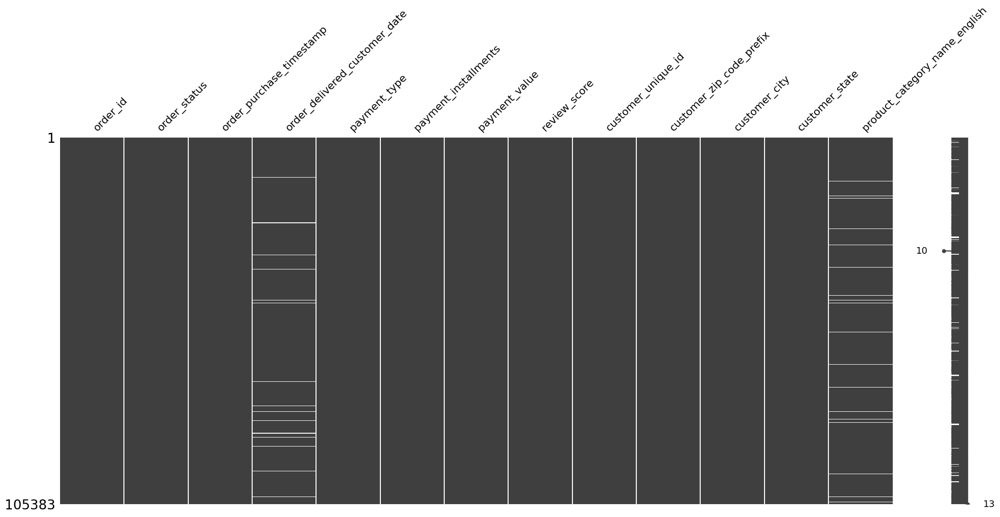

In [13]:
import missingno as mno
mno.matrix(data)

In [14]:
miss= data.loc[data['order_delivered_customer_date'].isnull()]
miss

,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,payment_type,payment_installments,payment_value,review_score,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,product_category_name_english
8,136cce7faa42fdb2cefd53fdc79a6098,invoiced,2017-04-11 12:22:08,NaT,credit_card,1.0,65.95,2,36edbb3fb164b1f16485364b6fb04c73,98900,santa rosa,RS,NaN
49,ee64d42b8cf066f35eac1cf57de1aa85,shipped,2018-06-04 16:44:48,NaT,boleto,1.0,22.36,1,08fb46d35bb3ab4037202c23592d1259,13215,jundiai,SP,health_beauty
111,0760a852e4e9d89eb77bf631eaaf1c84,invoiced,2018-08-03 17:44:42,NaT,boleto,1.0,50.35,3,c7f8d7b1fffc946d7069574f74c39f4e,88140,santo amaro da imperatriz,SC,christmas_supplies
137,15bed8e2fec7fdbadb186b57c46c92f2,processing,2017-09-03 14:22:03,NaT,credit_card,2.0,138.28,5,9f269af9c49244f6ba4a46985a3cfc2e,3436,sao paulo,SP,perfumery
164,6942b8da583c2f9957e990d028607019,shipped,2018-01-10 11:33:07,NaT,boleto,1.0,69.12,2,528b011eb7fab3d59c336cc7248eed3a,38600,paracatu,MG,perfumery
...,...,...,...,...,...,...,...,...,...,...,...,...,...
105219,3a3cddda5a7c27851bd96c3313412840,canceled,2018-08-31 16:13:44,NaT,voucher,1.0,63.89,5,e90598185d2427a35e32ef241a5c04aa,11075,santos,SP,NaN
105250,e9e64a17afa9653aacf2616d94c005b8,processing,2018-01-05 23:07:24,NaT,boleto,1.0,144.56,1,965191786b70912f793e4a777fd623cd,13050,campinas,SP,watches_gifts
105287,a89abace0dcc01eeb267a9660b5ac126,canceled,2018-09-06 18:45:47,NaT,voucher,1.0,107.13,4,d05c44a138277ad325d915c6b7ccbcdf,5344,sao paulo,SP,NaN
105288,a69ba794cc7deb415c3e15a0a3877e69,unavailable,2017-08-23 16:28:04,NaT,credit_card,2.0,195.91,1,e72a90a2b29fe1a8795b284aaaa3246f,22723,rio de janeiro,RJ,NaN


In [15]:
miss['order_status'].value_counts()

shipped        1180
canceled        662
unavailable     651
invoiced        330
processing      321
delivered         8
created           5
approved          2
Name: order_status, dtype: int64

## Colonne categ

### Observation

In [16]:
data.columns

Index(['order_id', 'order_status', 'order_purchase_timestamp',
       'order_delivered_customer_date', 'payment_type', 'payment_installments',
       'payment_value', 'review_score', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'product_category_name_english'],
      dtype='object')

In [17]:
categ = data[['order_status','payment_type','customer_city', 'customer_state',
       'product_category_name_english']]

In [18]:
for i in categ.columns :
    print("Pour",i,":")
    print("-----------")
    print(categ[i].value_counts())
    print("-----------")

Pour order_status :
-----------
delivered      102225
shipped          1180
canceled          669
unavailable       651
invoiced          330
processing        321
created             5
approved            2
Name: order_status, dtype: int64
-----------
Pour payment_type :
-----------
credit_card    77844
boleto         20066
voucher         5923
debit_card      1546
not_defined        3
Name: payment_type, dtype: int64
-----------
Pour customer_city :
-----------
sao paulo           16483
rio de janeiro       7317
belo horizonte       2918
brasilia             2225
curitiba             1590
                    ...  
marques de souza        1
alto piquiri            1
candido godoi           1
joaquim pires           1
nova vicosa             1
Name: customer_city, Length: 4119, dtype: int64
-----------
Pour customer_state :
-----------
SP    44245
RJ    13744
MG    12286
RS     5792
PR     5324
SC     3797
BA     3656
DF     2236
GO     2157
ES     2129
PE     1747
CE     1410
PA     1

### Le cas order_stat

In [19]:
order_stat = data['order_status'].value_counts(normalize = True)
order_stat

delivered      0.970033
shipped        0.011197
canceled       0.006348
unavailable    0.006177
invoiced       0.003131
processing     0.003046
created        0.000047
approved       0.000019
Name: order_status, dtype: float64

In [20]:
 values = order_stat
# Use `hole` to create a donut-like pie chart*
fig = go.Figure(data=[go.Pie(labels = ['delivered','shipped','canceled','unavailable','invoiced','processing','created,approved'],values=values, hole=.5)])

fig.show()

In [21]:
replace_name1 = ['approved', 'created','processing', 'invoiced','shipped']
for i in replace_name1:  
    data['order_status'] = data['order_status'].str.replace(i, 'undelivered')

In [22]:
new_order_stat = data['order_status'].value_counts(normalize = True)
new_order_stat

delivered      0.970033
undelivered    0.017441
canceled       0.006348
unavailable    0.006177
Name: order_status, dtype: float64

In [23]:
 values = new_order_stat
# Use `hole` to create a donut-like pie chart*
fig = go.Figure(data=[go.Pie(labels = ['delivered','undelivered','canceled','unavailable'],values=values, hole=.5)])

fig.show()

# Data visualisation

In [24]:
col = ['order_status', 'order_purchase_timestamp','order_delivered_customer_date','payment_type','payment_installments','payment_value', 'review_score','customer_city','customer_state','product_category_name_english']
for col in col:
        fig = px.histogram(data, x=col)
        fig.update_layout(bargap=0.2)
        fig.show()
       

# RFM de tout les clients

##  Creation des colonnes Recense, Frequence et m

In [25]:
#Date snapshot pour la récense ( date qu'on utilise pour comparer le derniere achat )
snapshot_date = data['order_purchase_timestamp'].max() + timedelta(days=1)
snapshot_date

Timestamp('2018-10-18 17:30:18')

In [26]:
#Groupby avec aggregate pour parametrer le groupby pour chaque colone 
#Lambda par rapport a la date pour la récense 
#count sur order id pour avoir le nombre d'achat par customer 
#Sum sur payment value pour le montant
data_process = data.groupby(['customer_unique_id']).agg({
        'order_purchase_timestamp': lambda x: (snapshot_date - x.max()).days,
        'order_id': 'count',
        'payment_value': 'sum'})


#Changer le nom des columns du nouveau dataframe
data_process.rename(columns={'order_purchase_timestamp': 'Recency',
                         'order_id': 'Frequency',
                         'payment_value': 'MonetaryValue'}, inplace=True)


# Print top 5 rows and shape of dataframe
print(data_process.head())
print('{:,} rows; {:,} columns'
      .format(data_process.shape[0], data_process.shape[1]))


data_process.sort_values(by='Frequency', ascending=False)

                                  Recency  Frequency  MonetaryValue
customer_unique_id                                                 
0000366f3b9a7992bf8c76cfdf3221e2      161          1         141.90
0000b849f77a49e4a4ce2b2a4ca5be3f      164          1          27.19
0000f46a3911fa3c0805444483337064      586          1          86.22
0000f6ccb0745a6a4b88665a16c9f078      370          1          43.62
0004aac84e0df4da2b147fca70cf8255      337          1         196.89
96,096 rows; 3 columns


,Recency,Frequency,MonetaryValue
customer_unique_id,,,
9a736b248f67d166d2fbb006bcb877c3,435,54,394.81
8af7ac63b2efbcbd88e5b11505e8098a,546,29,457.99
569aa12b73b5f7edeaa6f2a01603e381,498,26,62.68
1d2435aa3b858d45c707c9fc25e18779,639,24,233.70
90807fdb59eec2152bc977feeb6e47e7,327,24,215.70
...,...,...,...
57cd75ea0d4df751cb635cbae8596411,374,1,158.09
57cd06ab5e1452f461555dda1deb3d5c,257,1,124.27
57cce8aaddd9bf6acc0d54ffdd68a0ac,84,1,350.34


In [27]:
# # Plot RFM distributions
# plt.figure(figsize=(12,10))
# # Plot distribution of R
# plt.subplot(3, 1, 1); sns.distplot(data_process['Recency'])
# # Plot distribution of F
# plt.subplot(3, 1, 2); sns.distplot(data_process['Frequency'])
# # Plot distribution of M
# plt.subplot(3, 1, 3); sns.distplot(data_process['MonetaryValue'])
# # Show the plot
# plt.show()

In [28]:
# qui= data_process.loc[data_process['Frequency']==1]
# qui

In [29]:
df= data_process.loc[data_process['Frequency'] !=1]
data2 = df.copy()

In [30]:
# col = ['Recency', 'MonetaryValue']
# for col in col:
#         fig = px.histogram(qui, x=col)
#         fig.update_layout(bargap=0.2)
#         fig.show()

In [31]:
df_merge = pd.merge(data,data_process , on='customer_unique_id', how='outer',indicator=True)

In [32]:
quid= df_merge.loc[df_merge['Frequency']==1]
quid

,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,payment_type,payment_installments,payment_value,review_score,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,product_category_name_english,Recency,Frequency,MonetaryValue,_merge
4,53cdb2fc8bc7dce0b6741e2150273451,delivered,2018-07-24 20:41:37,2018-08-07 15:27:45,boleto,1.0,141.46,4,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,perfumery,85,1,141.46,both
5,47770eb9100c2d0c44946d9cf07ec65d,delivered,2018-08-08 08:38:49,2018-08-17 18:06:29,credit_card,3.0,179.12,5,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,auto,71,1,179.12,both
6,949d5b44dbf5de918fe9c16f97b45f8a,delivered,2017-11-18 19:28:06,2017-12-02 00:28:42,credit_card,1.0,72.20,5,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN,pet_shop,333,1,72.20,both
7,ad21c59c0840e6cb83a9ceb5573f8159,delivered,2018-02-13 21:18:39,2018-02-16 18:17:02,credit_card,1.0,28.62,5,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP,stationery,246,1,28.62,both
8,a4591c265e18cb1dcee52889e2d8acc3,delivered,2017-07-09 21:57:05,2017-07-26 10:57:55,credit_card,6.0,175.26,4,80bb27c7c16e8f973207a5086ab329e2,86320,congonhinhas,PR,auto,465,1,175.26,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105378,9c5dedf39a927c1b2549525ed64a053c,delivered,2017-03-09 09:54:05,2017-03-17 15:08:01,credit_card,3.0,85.08,5,6359f309b166b0196dbf7ad2ac62bb5a,12209,sao jose dos campos,SP,health_beauty,588,1,85.08,both
105379,63943bddc261676b46f01ca7ac2f7bd8,delivered,2018-02-06 12:58:58,2018-02-28 17:37:56,credit_card,3.0,195.00,4,da62f9e57a76d978d02ab5362c509660,11722,praia grande,SP,baby,254,1,195.00,both
105380,83c1379a015df1e13d02aae0204711ab,delivered,2017-08-27 14:46:43,2017-09-21 11:24:17,credit_card,5.0,271.01,5,737520a9aad80b3fbbdad19b66b37b30,45920,nova vicosa,BA,home_appliances_2,417,1,271.01,both
105381,11c177c8e97725db2631073c19f07b62,delivered,2018-01-08 21:28:27,2018-01-25 23:32:54,credit_card,4.0,441.16,2,5097a5312c8b157bb7be58ae360ef43c,28685,japuiba,RJ,computers_accessories,282,1,441.16,both


In [33]:
# col = ['order_status', 'order_purchase_timestamp','order_delivered_customer_date','payment_type','payment_installments','payment_value', 'review_score','customer_city','customer_state','product_category_name_english']
# for col in col:
#         fig = px.histogram(quid, x=col)
#         fig.update_layout(bargap=0.2)
#         fig.show()

In [34]:
quid= df_merge.loc[df_merge['Frequency'] != 1]
quid

,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,payment_type,payment_installments,payment_value,review_score,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,product_category_name_english,Recency,Frequency,MonetaryValue,_merge
0,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,credit_card,1.0,18.12,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares,381,4,82.82,both
1,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,voucher,1.0,2.00,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares,381,4,82.82,both
2,e481f51cbdc54678b7cc49136f2d6af7,delivered,2017-10-02 10:56:33,2017-10-10 21:25:13,voucher,1.0,18.59,4,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,housewares,381,4,82.82,both
3,69923a4e07ce446644394df37a710286,delivered,2017-09-04 11:26:38,2017-09-05 19:20:20,credit_card,1.0,44.11,5,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,baby,381,4,82.82,both
12,e69bfb5eb88e0ed6a785585b27e16dbf,delivered,2017-07-29 11:55:02,2017-08-16 17:14:30,voucher,1.0,161.42,5,299905e3934e9e181bfb2e164dd4b4f8,18075,sorocaba,SP,office_furniture,446,2,169.76,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105284,4bafa54db6b060da198f23f810835969,delivered,2018-04-05 14:46:51,2018-04-30 21:41:07,voucher,1.0,8.13,5,6e11aa7fefec6405ba35e05a8c0f9b0e,66073,belem,PA,furniture_decor,196,3,85.61,both
105373,9115830be804184b91f5c00f6f49f92d,delivered,2017-10-04 19:57:37,2017-10-20 20:25:45,credit_card,2.0,42.42,5,c716cf2b5b86fb24257cffe9e7969df8,78048,cuiaba,MT,toys,378,2,106.79,both
105374,9115830be804184b91f5c00f6f49f92d,delivered,2017-10-04 19:57:37,2017-10-20 20:25:45,voucher,1.0,64.37,5,c716cf2b5b86fb24257cffe9e7969df8,78048,cuiaba,MT,toys,378,2,106.79,both
105375,aa04ef5214580b06b10e2a378300db44,delivered,2017-01-27 00:30:03,2017-02-07 13:15:25,voucher,1.0,250.00,5,e03dbdf5e56c96b106d8115ac336f47f,35502,divinopolis,MG,health_beauty,629,2,389.43,both


In [35]:
# col = ['order_status', 'order_purchase_timestamp','order_delivered_customer_date','payment_type','payment_installments','payment_value', 'review_score','customer_city','customer_state','product_category_name_english']
# for col in col:
#         fig = px.histogram(quid, x=col)
#         fig.update_layout(bargap=0.2)
#         fig.show()

## outliers 

In [36]:
# plot_multiple_boxplots(qui)

In [37]:
outlier_identificator(data_process,'Recency')

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
4854e9b3feff728c13ee5fc7d1547e92,773,1,75.06
b7d76e111c89f7ebf14761390f0f7d17,773,1,136.23
009b0127b727ab0ba422f6d9604487c7,765,1,40.95
830d5b7aaa3b6f1e9ad63703bec97d23,763,1,0.00


In [38]:
outlier_identificator(data_process,'Frequency')

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
9a736b248f67d166d2fbb006bcb877c3,435,54,394.81
8af7ac63b2efbcbd88e5b11505e8098a,546,29,457.99
569aa12b73b5f7edeaa6f2a01603e381,498,26,62.68
db1af3fd6b23ac3873ef02619d548f9c,468,24,658.44
1d2435aa3b858d45c707c9fc25e18779,639,24,233.70
...,...,...,...
5ec2088063a452edc9e72375fccec9f8,155,2,68.93
5ebc9e66c6f7fc4edad3775ce325f4e3,262,2,63.27
5ea60a7885845fffcd48d8aea054ec26,230,2,72.50


In [39]:
outlier_identificator(data_process,'MonetaryValue')

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
0a0a92112bd4c708ca5fde585afaa872,384,1,13664.08
46450c74a0d8c5ca9395da1daac6c120,61,3,9553.02
da122df9eeddfedc1dc1f5349a1a690c,565,2,7571.63
763c8b1c9c68a0229c42c9fc6f662b93,95,1,7274.88
dc4802a71eae9be1dd28f5d788ceb526,612,1,6929.31
...,...,...,...
76452dccd38534f1cd8b0c0245c57b76,367,1,368.92
1d41d4877b1d13802db2a5cc6a7f4e64,390,1,368.92
841163588d4103f539c4a4a30474eff5,422,1,368.92


## Clustering

In [40]:
data_process.describe()

,Recency,Frequency,MonetaryValue
count,96096.000000,96096.000000,96096.000000
mean,288.735691,1.096643,169.558320
std,153.414676,0.534676,237.929113
min,1.000000,1.000000,0.000000
25%,164.000000,1.000000,63.220000
50%,269.000000,1.000000,108.300000
75%,398.000000,1.000000,185.495000
max,773.000000,54.000000,13664.080000


In [41]:
data_process['R'] = pd.cut(data_process['Recency'] , bins=[0, 269, 398, 774], labels=[3,2,1])

data_process['F'] = pd.cut(data_process['Frequency'] , bins=[0, 1, 5, 55], labels=[1,2,3])

data_process['M'] = pd.cut(data_process['MonetaryValue'] , bins=[-1, 108, 185, 13665], labels=[1,2,3])

In [42]:
data_process.sort_values(by='Recency', ascending=False)

,Recency,Frequency,MonetaryValue,R,F,M
customer_unique_id,,,,,,
4854e9b3feff728c13ee5fc7d1547e92,773,1,75.06,1,1,1
b7d76e111c89f7ebf14761390f0f7d17,773,1,136.23,1,1,2
009b0127b727ab0ba422f6d9604487c7,765,1,40.95,1,1,1
830d5b7aaa3b6f1e9ad63703bec97d23,763,1,0.00,1,1,1
0eb1ee9dba87f5b36b4613a65074337c,745,1,109.34,1,1,2
...,...,...,...,...,...,...
9bb92bebd4cb7511e1a02d5e50bc4655,19,1,137.03,3,1,2
634420a0ea42302205032ed44ac7fccc,17,2,160.76,3,2,2
af5454198a97379394cacf676e1e96cb,14,3,592.65,3,2,3


In [43]:
rfm = data_process[['R','F','M']]

In [44]:
for i in rfm.columns:
    print(i)
    print('--------------------')
    print(rfm[i].value_counts())
    print("---------------------------------------------------------------")

R
--------------------
3    48075
2    24067
1    23954
Name: R, dtype: int64
---------------------------------------------------------------
F
--------------------
1    89630
2     6291
3      175
Name: F, dtype: int64
---------------------------------------------------------------
M
--------------------
1    47900
2    24102
3    24094
Name: M, dtype: int64
---------------------------------------------------------------


In [45]:
data_process = data_process.reset_index()
# Concat RFM quartile values to create RFM Segments
def join_rfm(x): return str(x['R']) + str(x['F']) + str(x['M'])
data_process['RFM_Segment_Concat'] = data_process.apply(join_rfm, axis=1)


In [46]:
data_process['RFM_Segment_Concat'].nunique()

27

In [47]:
data_process.dtypes

customer_unique_id      object
Recency                  int64
Frequency                int64
MonetaryValue          float64
R                     category
F                     category
M                     category
RFM_Segment_Concat      object
dtype: object

In [48]:
data_process['RFM_Segment_Concat'].value_counts()

311    22653
111    11797
312    11699
211    11628
313    10486
212     5648
112     5352
213     5187
113     5180
323     1686
321      795
223      784
322      682
123      682
121      511
221      459
122      365
222      327
333       40
133       31
131       23
331       21
233       18
132       13
231       13
332       13
232        3
Name: RFM_Segment_Concat, dtype: int64

In [49]:
conditions  = [(data_process['RFM_Segment_Concat'] == "311"),(data_process['RFM_Segment_Concat'] == "111"),(data_process['RFM_Segment_Concat'] == "113"),(data_process['RFM_Segment_Concat'] == "313") | (data_process['RFM_Segment_Concat'] == "312") | (data_process['RFM_Segment_Concat'] == "213"),
             (data_process['RFM_Segment_Concat'] == "211") | (data_process['RFM_Segment_Concat'] == "212") | (data_process['RFM_Segment_Concat'] == "112")]

choices = ['New Customers',"One time Customers","Single heavy purchase","Can't loose them","One Time with higher purchase"]

data_process["RFM_Level"] = np.select(conditions, choices, default="Further investigation")

In [50]:
# data_process = data_process.astype({'R':'int'})
# data_process = data_process.astype({'F':'int'})
# data_process = data_process.astype({'M':'int'})

# data_process['RFM_Score'] = 0.15*data_process['R']+0.28 * \
#     data_process['F']+0.57*data_process['M']
# data_process['RFM_Score'] *= 3
# data_process = data_process.round(2)
# data_process[['customer_unique_id', 'RFM_Score']].describe()

# data_process = data_process.astype({'RFM_Score':'int'})



data_process['RFM_Level'].value_counts()

# Calculate average values for each RFM_Level, and return a size of each segment 
rfm_level_agg = data_process.groupby('RFM_Level').agg({
    'Recency': 'mean',
    'Frequency': 'mean',
    'MonetaryValue': ['mean', 'count']
}).round(1)
# Print the aggregated dataset
print(rfm_level_agg)

                              Recency Frequency MonetaryValue       
                                 mean      mean          mean  count
RFM_Level                                                           
Can't loose them                193.7       1.0         285.6  27372
Further investigation           287.5       2.4         289.8   6466
New Customers                   162.0       1.0          63.1  22653
One Time with higher purchase   369.8       1.0         101.9  22628
One time Customers              502.2       1.0          63.7  11797
Single heavy purchase           506.4       1.0         408.5   5180


In [51]:
# rfm_level_agg.columns = rfm_level_agg.columns.droplevel()
# rfm_level_agg.columns = ['RecencyMean','FrequencyMean','MonetaryMean', 'Count']
# #Create our plot and resize it.
# fig = plt.gcf()
# ax = fig.add_subplot()
# fig.set_size_inches(16, 9)
# squarify.plot(sizes=rfm_level_agg['Count'], 
#               label=["Can't loose them","More than two purchase",'New Customers',"One Time with higher purchase","One time Customers","Single Medium purchase"]
#               , alpha=.6 )
# plt.title("RFM Segments",fontsize=18,fontweight="bold")
# plt.axis('off')
# plt.show()

# RFM des clients qui ont commandé plus d'une fois 

In [52]:
data2

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
000bfa1d2f1a41876493be685390d6d3,384,2,93.70
000e309254ab1fc5ba99dd469d36bdb4,115,2,78.42
000fbf0473c10fc1ab6f8d2d286ce20c,84,2,724.76
00172711b30d52eea8b313a7f2cced02,66,2,244.14
001926cef41060fae572e2e7b30bd2a4,427,2,182.42
...,...,...,...
ff9584b796ae561b0085ebc998880a64,209,2,50.05
ff9bc66daa6702543b16f3c4897e300b,591,2,97.99
ff9c04f464ea62ad7787a0218336b942,200,2,91.38


In [53]:
data2.describe()

,Recency,Frequency,MonetaryValue
count,6466.000000,6466.000000,6466.000000
mean,287.463192,2.436282,289.795099
std,152.158490,1.524751,372.103382
min,1.000000,2.000000,9.590000
25%,162.000000,2.000000,99.735000
50%,269.000000,2.000000,185.600000
75%,399.000000,2.000000,344.050000
max,744.000000,54.000000,9553.020000


In [54]:
data2['R'] = pd.cut(data2['Recency'] , bins=[0, 269, 398, 774], labels=[3,2,1])

data2['F'] = pd.cut(data2['Frequency'] , bins=[0,2, 15, 55], labels=[1,2,3])

data2['M'] = pd.cut(data2['MonetaryValue'] , bins=[8, 185, 344, 10000], labels=[1,2,3])

In [55]:
data2

,Recency,Frequency,MonetaryValue,R,F,M
customer_unique_id,,,,,,
000bfa1d2f1a41876493be685390d6d3,384,2,93.70,2,1,1
000e309254ab1fc5ba99dd469d36bdb4,115,2,78.42,3,1,1
000fbf0473c10fc1ab6f8d2d286ce20c,84,2,724.76,3,1,3
00172711b30d52eea8b313a7f2cced02,66,2,244.14,3,1,2
001926cef41060fae572e2e7b30bd2a4,427,2,182.42,1,1,1
...,...,...,...,...,...,...
ff9584b796ae561b0085ebc998880a64,209,2,50.05,3,1,1
ff9bc66daa6702543b16f3c4897e300b,591,2,97.99,1,1,1
ff9c04f464ea62ad7787a0218336b942,200,2,91.38,3,1,1


In [56]:
rfm2 = data2[['R','F','M']]

In [57]:
for i in rfm2.columns:
    print(i)
    print('--------------------')
    print(rfm2[i].value_counts())
    print("---------------------------------------------------------------")

R
--------------------
3    3237
1    1625
2    1604
Name: R, dtype: int64
---------------------------------------------------------------
F
--------------------
1    5130
2    1324
3      12
Name: F, dtype: int64
---------------------------------------------------------------
M
--------------------
1    3225
2    1623
3    1618
Name: M, dtype: int64
---------------------------------------------------------------


In [58]:
data2 = data2.reset_index()
# Concat RFM quartile values to create RFM Segments
def join_rfm(x): return str(x['R']) + str(x['F']) + str(x['M'])
data2['RFM_Segment_Concat'] = data2.apply(join_rfm, axis=1)


In [59]:
data2['RFM_Segment_Concat'].nunique()

24

In [60]:
data2['RFM_Segment_Concat'].value_counts()

311    1268
111     726
312     707
211     661
313     630
212     321
213     288
112     280
113     249
321     243
323     239
121     184
322     149
221     140
223     105
123     101
222      86
122      77
133       5
131       2
232       2
132       1
231       1
333       1
Name: RFM_Segment_Concat, dtype: int64

In [61]:
data2 = data2.astype({'R':'int'})
data2 = data2.astype({'F':'int'})
data2 = data2.astype({'M':'int'})

In [62]:
data2['RFM_Score'] = 0.15*data2['R']+0.28 * \
    data2['F']+0.57*data2['M']
data2['RFM_Score'] *= 3
data2 = data2.round(2)
data2[['customer_unique_id', 'RFM_Score']].describe()

,RFM_Score
count,6466.000000
mean,5.022318
std,1.559431
min,3.000000
25%,3.900000
50%,4.710000
75%,6.420000
max,9.000000


In [63]:

# data2 = data2.astype({'RFM_Score':'int'})

# conditions  = [  (data2['RFM_Score'] >= 8 ) ,(data2['RFM_Score'] >= 6) & (data2['RFM_Score'] < 8),(data2['RFM_Score'] >= 4) & (data2['RFM_Score'] < 6),(data2['RFM_Score'] >= 3) & (data2['RFM_Score'] < 4)]

# choices = ['Champions','Loyal','Potential','Require Activation' ]

# data2["RFM_Level"] = np.select(conditions, choices, default=np.nan)

# data2['RFM_Level'].value_counts()

# # Calculate average values for each RFM_Level, and return a size of each segment 
# rfm_level_agg = data2.groupby('RFM_Level').agg({
#     'Recency': 'mean',
#     'Frequency': 'mean',
#     'MonetaryValue': ['mean', 'count']
# }).round(1)
# # Print the aggregated dataset
# print(rfm_level_agg)

# Monitoring

In [125]:
df_co = df_merge.loc[df_merge['Frequency']!=1]

In [255]:
df = data.dropna()

In [256]:
df = df.drop(['order_id','order_delivered_customer_date','payment_installments','customer_unique_id',
              'customer_zip_code_prefix','customer_city'
             ],axis=1)

In [257]:
df

,order_status,order_purchase_timestamp,payment_type,payment_value,review_score,customer_state,product_category_name_english
0,delivered,2017-10-02 10:56:33,credit_card,18.12,4,SP,housewares
1,delivered,2017-10-02 10:56:33,voucher,2.00,4,SP,housewares
2,delivered,2017-10-02 10:56:33,voucher,18.59,4,SP,housewares
3,delivered,2018-07-24 20:41:37,boleto,141.46,4,BA,perfumery
4,delivered,2018-08-08 08:38:49,credit_card,179.12,5,GO,auto
...,...,...,...,...,...,...,...
105378,delivered,2017-03-09 09:54:05,credit_card,85.08,5,SP,health_beauty
105379,delivered,2018-02-06 12:58:58,credit_card,195.00,4,SP,baby
105380,delivered,2017-08-27 14:46:43,credit_card,271.01,5,BA,home_appliances_2
105381,delivered,2018-01-08 21:28:27,credit_card,441.16,2,RJ,computers_accessories


In [258]:
def info(df):
    print(df.info())
    print('------------')
    print(df.describe())
    print('------------')
    print(df.nunique())
    print('------------------------------------------------')
    for i in df:
        uni =df[i].unique()
        print(i)
        print(uni)
        print('-----------------')

In [259]:
from sklearn.preprocessing import OneHotEncoder, RobustScaler

In [260]:
encode = ['order_status','payment_type','review_score','customer_state','product_category_name_english']

In [261]:
df = pd.get_dummies(df, columns=encode)

In [262]:
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import adjusted_rand_score

In [266]:
df

,order_purchase_timestamp,payment_value,order_status_canceled,order_status_delivered,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_voucher,review_score_1,review_score_2,...,product_category_name_english_security_and_services,product_category_name_english_signaling_and_security,product_category_name_english_small_appliances,product_category_name_english_small_appliances_home_oven_and_coffee,product_category_name_english_sports_leisure,product_category_name_english_stationery,product_category_name_english_tablets_printing_image,product_category_name_english_telephony,product_category_name_english_toys,product_category_name_english_watches_gifts
0,2017-10-02 10:56:33,18.12,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2017-10-02 10:56:33,2.00,0,1,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2017-10-02 10:56:33,18.59,0,1,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2018-07-24 20:41:37,141.46,0,1,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2018-08-08 08:38:49,179.12,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105378,2017-03-09 09:54:05,85.08,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
105379,2018-02-06 12:58:58,195.00,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
105380,2017-08-27 14:46:43,271.01,0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
105381,2018-01-08 21:28:27,441.16,0,1,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [284]:
def monitoringue(data):
    
    N = df[df['order_purchase_timestamp'].dt.year == 2016]
    N = N.sort_values(by='order_purchase_timestamp')
    N = N.drop(['order_purchase_timestamp'],axis=1)
    
    année = 2017
    mois = 1
    
    M0 = KMeans(n_clusters=3, random_state=0, n_init="auto").fit(N)
    
    scores = []
    
    #pour année
    for i in range(0,3):
        #pour mois
        for u in range(0,12):
            n = df[(df['order_purchase_timestamp'].dt.year == année+i) & (df['order_purchase_timestamp'].dt.month == mois+u)]
            n = n.dropna()
            n = n.sort_values(by='order_purchase_timestamp')
            n = n.drop(['order_purchase_timestamp'],axis=1)
            
            Nn = df[df['order_purchase_timestamp'] < f'{année+i}-{mois+u}-01']
            Nn = Nn.sort_values(by='order_purchase_timestamp')
            Nn = Nn.drop(['order_purchase_timestamp'],axis=1)
            
            if n.shape[0] == 0:
                continue
                
            M1 = KMeans(n_clusters=3, random_state=0, n_init="auto").fit(Nn)
            
            C1 = M0.predict(n)
            C11 = M1.predict(n)

            result = adjusted_rand_score(C1, C11)
            score.append(result)
            
            if result <= 0.8:
                N = n
                print('réentrainement')
            
            print(f'année {année+i} mois {mois+u}')
            print(f'score ARI: {result}')
            print()

année 2017 mois 1
score ARI: 1.0

réentrainement
année 2017 mois 2
score ARI: 0.6142839494312221

réentrainement
année 2017 mois 3
score ARI: 0.3372994970919396

réentrainement
année 2017 mois 4
score ARI: 0.44765821814942697

réentrainement
année 2017 mois 5
score ARI: 0.4779517530277398

réentrainement
année 2017 mois 6
score ARI: 0.45801490969477243

réentrainement
année 2017 mois 7
score ARI: 0.36289234633044837

réentrainement
année 2017 mois 8
score ARI: 0.48466770646492324

réentrainement
année 2017 mois 9
score ARI: 0.6264336738665808

réentrainement
année 2017 mois 10
score ARI: 0.6287492888191997

réentrainement
année 2017 mois 11
score ARI: 0.27446658691525383

réentrainement
année 2017 mois 12
score ARI: 0.5388411220936417

réentrainement
année 2018 mois 1
score ARI: 0.5891069018438075

réentrainement
année 2018 mois 2
score ARI: 0.6368693555207837

réentrainement
année 2018 mois 3
score ARI: 0.6546114184299364

réentrainement
année 2018 mois 4
score ARI: 0.6454129211798217

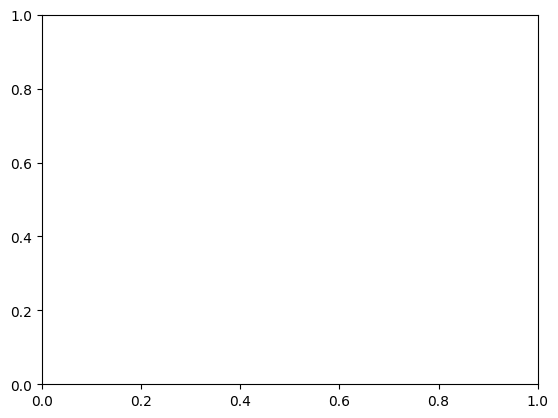

In [285]:
monitoringue(df)

In [267]:
#2016
N = df[df['order_purchase_timestamp'].dt.year == 2016]
N = N.sort_values(by='order_purchase_timestamp')
N = N.drop(['order_purchase_timestamp'],axis=1)

In [118]:
#1er mois de 2017
n1 = df[(df['order_purchase_timestamp'].dt.year == 2017) & (df['order_purchase_timestamp'].dt.month == 1)]
n1 = n1.dropna()
n1 = n1.sort_values(by='order_purchase_timestamp')
n1 = n1.drop(['order_purchase_timestamp'],axis=1)

In [119]:
#2016 + 1er moois de 2017
Nn1 = df[df['order_purchase_timestamp'] < '2017-02-01']
Nn1 = Nn1.sort_values(by='order_purchase_timestamp')
Nn1 = Nn1.drop(['order_purchase_timestamp'],axis=1)

In [167]:
n1.shape == (176, 110)

True

In [120]:
M0 = KMeans(n_clusters=3, random_state=0, n_init="auto").fit(N)
M1 = KMeans(n_clusters=3, random_state=0, n_init="auto").fit(Nn1)

In [ ]:
modele 2016
modele 2016 + 1 janvier 2017

fit 1 janvier 2017

In [121]:
#true
C1 = M0.predict(n1)

#pred
C11 = M1.predict(n1)

In [122]:
adjusted_rand_score(C1, C11)

0.9396099384786961